In [2]:
import xarray as xr
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
from pyproj import Proj
import cartopy.feature as cfeature
from pathlib import Path
import cmaqsatproc as csp
import pyrsig
import pycno

In [2]:
plt.rcParams.update({
    'figure.figsize': (8, 6),                # Large, readable figures
    'figure.dpi': 400,                       # High resolution for publication
    'axes.titlesize': 18,                    # Large title font
    'figure.titlesize': 'large',
    'axes.labelsize': 16,                    # Large axis label font
    'axes.linewidth': 1.5,                   # Thicker axes lines
    'axes.grid': True,                       # Grid for readability
    'grid.alpha': 0.3,                       # Subtle grid lines
    'xtick.labelsize': 14,                   # Large tick labels
    'ytick.labelsize': 14,
    'xtick.direction': 'in',                 # Ticks inside
    'ytick.direction': 'in',
    'xtick.major.size': 7,                   # Larger major ticks
    'ytick.major.size': 7,
    'xtick.minor.size': 4,
    'ytick.minor.size': 4,
    'legend.fontsize': 14,                   # Large legend font
    'legend.frameon': False,                 # No legend frame
    'savefig.bbox': 'tight',                 # Tight bounding box for saving
    'savefig.transparent': True,             # Transparent background
    'font.family': 'sans-serif',             # Clean font
    'font.sans-serif': ['Arial', 'Helvetica', 'DejaVu Sans'],
    'lines.linewidth': 2,                    # Thicker lines
    'lines.markersize': 8,                   # Larger markers
    'pdf.fonttype': 42,                      # Editable text in PDFs
    'ps.fonttype': 42,
    'xtick.major.pad': 7,
    'ytick.major.pad': 7,
    'axes.facecolor': 'gainsboro',         # Light background for axes
    'figure.facecolor': 'white',
    'legend.loc': 'best',
    'errorbar.capsize': 4,
 
})

In [3]:
# Define projection
proj4 = '+proj=lcc +lat_0=40.0 +lon_0=97.0 +lat_1=33.0 +lat_2=45.0 +x_0=2952000.0 +y_0=2772000.0 +R=6370000.0 +to_meter=36000.0 +no_defs'
cmaq_proj = ccrs.LambertConformal(central_latitude=40.0, central_longitude=-97.0, 
                                  standard_parallels=(33.0, 45.0))
                                  
gf = pyrsig.open_ioapi('/work/MOD3DEV/jkumm/EMBER/CMAQ/36US3/input/mcip/aqm.t12z.grdcro2d_20230501.ncf')
proj = Proj(gf.crs_proj4)

In [4]:
# Root directory
root_dir = Path("/work/MOD3DEV/jkumm/EMBER/CMAQ/36US3/eval/POST/")

# Run configurations
runs = {
    "BASE" : ("EMBER_BASE", "NOASSIM"),
    "ASSIM" : ("EMBER_ASSIM", "ASSIM"),
    # "SCALE" : ("EMBER_SCALE_ASSIM_i5", "SCALE5_FINAL"),
    "SCALE_ASSIM" : ("EMBER_SCALE_ASSIM_FINAL_202506", "ASSIM8_FINAL")

}
months = ["05", "06", "07", "08", "09"]  # May - September 2023
variables = ["NO2_DAILYAV", "O3_MDA8"]

In [5]:
def preprocess(ds):
    """
    Preprocess each dataset to exclude the last timestep.
    """
    return ds.isel(TSTEP=slice(None, -1))

def load_data():
    datasets = {}
    for run_name, (run_dir, run_id) in runs.items():
        file_list = [root_dir / run_dir / 
                     f"HR2DAY_LST_ACONC_CMAQv54_cb6r5_ae7_aq.36US3.35.{run_id}_2023{month}.nc"
                     for month in months]
        
        # Use preprocess to exclude the last timestep from each file
        ds = xr.open_mfdataset(file_list, combine='nested', concat_dim='TSTEP', 
                               data_vars='minimal', coords='minimal', engine='netcdf4',
                               preprocess=preprocess)
        
        # Update TSTEP to reflect the correct dates
        total_days = len(ds['TSTEP'])
        ds['TSTEP'] = pd.date_range('2023-05-01', periods=total_days, freq='D')
        
        datasets[run_name] = ds
    return datasets

full_datasets = load_data()

In [6]:
def compute_coords(ds):
    xcell = ds.attrs.get("XCELL", 36000)
    ycell = ds.attrs.get("YCELL", 36000)
    ncols = ds.attrs.get("NCOLS", 172)
    nrows = ds.attrs.get("NROWS", 148)
    xorig = ds.attrs.get("XORIG", -2952000)
    yorig = ds.attrs.get("YORIG", -2772000)
    
    xcoords = np.arange(0, xcell * ncols, xcell) + xorig
    ycoords = np.arange(0, ycell * nrows, ycell) + yorig
    X, Y = np.meshgrid(xcoords, ycoords, indexing='xy')
    return X, Y

# Use BASE dataset for coordinates (assuming all runs share the same grid)
X, Y = compute_coords(full_datasets["BASE"])

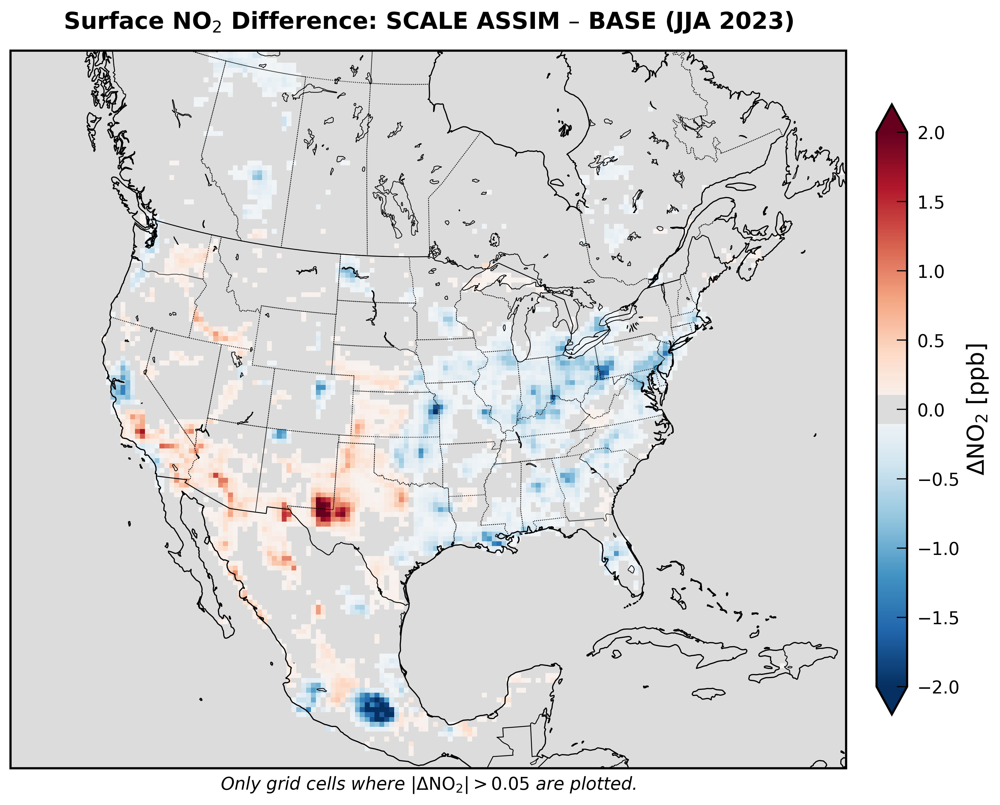

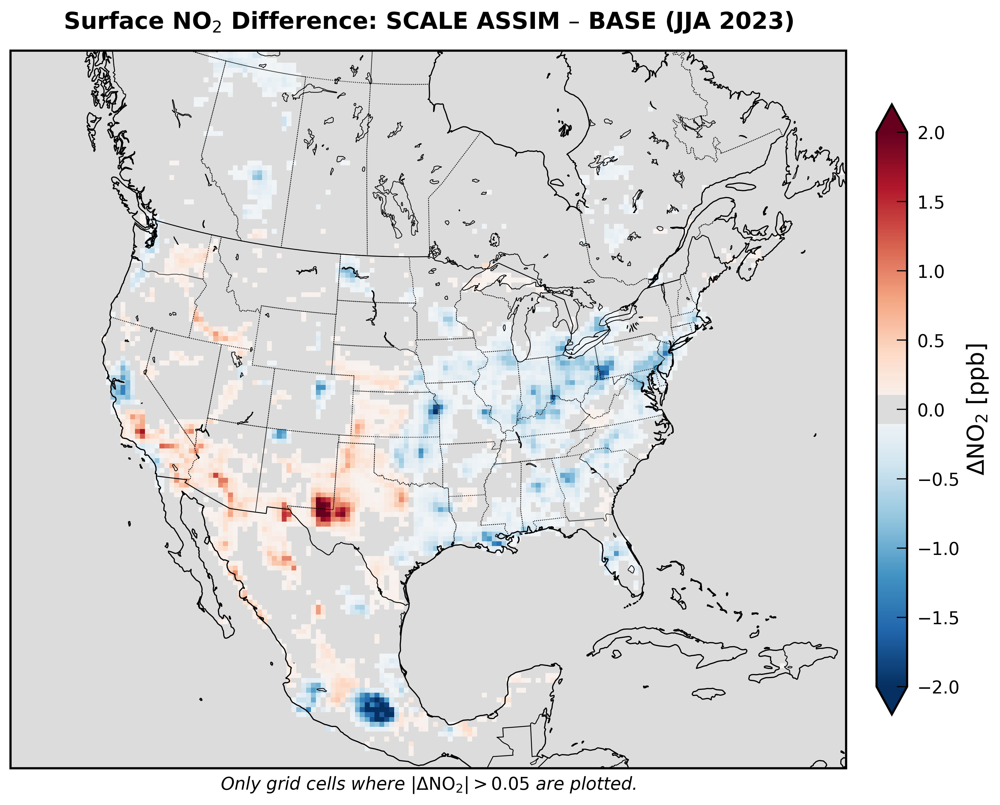

In [31]:
def plot_overall_surface_no2(datasets, X, Y, filename=None):
    """
    Plot domain-wide, time-averaged surface daily average NO₂ change (SCALE ASSIM - BASE).
    Uses continuous RdBu_r colormap, gainsboro background, and Cartopy features.
    """
    import matplotlib.pyplot as plt
    from matplotlib.colors import TwoSlopeNorm
    import numpy as np
    import cartopy.crs as ccrs
    import cartopy.feature as cfeature

    run = "SCALE_ASSIM"
    base_run = "BASE"
    # no2 = datasets[run]["NO2_DAILYAV"].mean(dim="TSTEP").isel(LAY=0)
    # base_no2 = datasets[base_run]["NO2_DAILYAV"].mean(dim="TSTEP").isel(LAY=0)

        # Assuming TSTEP is a pandas.DatetimeIndex
    jja_mask = (datasets["BASE"]["TSTEP"].dt.month >= 6) & (datasets["BASE"]["TSTEP"].dt.month <= 8)
    no2_jja = datasets[run]["NO2_DAILYAV"].isel(TSTEP=jja_mask).mean(dim="TSTEP").isel(LAY=0)
    base_no2_jja = datasets[base_run]["NO2_DAILYAV"].isel(TSTEP=jja_mask).mean(dim="TSTEP").isel(LAY=0)
    no2_diff_jja = no2_jja - base_no2_jja
    no2_diff = no2_diff_jja
    # no2_diff = no2 - base_no2  # No masking
    no2_diff = no2_diff.where(np.abs(no2_diff) > 0.05)  # Mask values below threshold
    vmax = 2

    fig = plt.figure(figsize=(10, 8.6))
    ax = plt.axes(projection=cmaq_proj)
    mesh = ax.pcolormesh(X, Y, no2_diff, cmap="RdBu_r", vmin=-vmax, vmax=vmax, transform=cmaq_proj)
    ax.set_facecolor('gainsboro')
    ax.text(0.5, -0.03, "Only grid cells where $|\Delta \mathrm{NO}_2| > 0.05$ are plotted.", transform=ax.transAxes, ha='center', fontsize=12, fontstyle='italic')
    ax.add_feature(cfeature.COASTLINE.with_scale('50m'), linewidth=0.8)
    ax.add_feature(cfeature.BORDERS.with_scale('50m'), linewidth=0.6)
    ax.add_feature(cfeature.STATES.with_scale('50m'), linestyle=":", linewidth=0.5)
    ax.add_feature(cfeature.LAKES.with_scale('50m'), edgecolor='black', facecolor='none', linewidth=0.5)

    cbar = plt.colorbar(mesh, ax=ax, pad=0.03, shrink=0.7, extend='both')
    cbar.ax.tick_params(labelsize=12)
    cbar.set_label("ΔNO$_2$ [ppb]", fontsize=16)
    from matplotlib.patches import Rectangle

    # Add rectangle above the colorbar
    cbar.ax.add_patch(
        Rectangle(
            (0, 0.475),   # x, y position (left of colorbar, just above)
            1.0, 0.05,       # width, height
            transform=cbar.ax.transAxes,
            color='gainsboro',
            clip_on=False
        )
    )
 
    ax.set_title("Surface NO$_2$ Difference: SCALE ASSIM – BASE (JJA 2023)", fontsize=16, weight="bold", pad=15)
    ax.set_aspect("equal")
    ax.set_extent([-2952000, 3204000, -2772000, 2520000], crs=cmaq_proj)
    plt.tight_layout()
    if filename:
        plt.savefig(f'./final_plots/{filename}', dpi=400, bbox_inches="tight", transparent=False)

    plt.show()

plot_overall_surface_no2(full_datasets, X, Y, filename="overall_surface_no2.png")
plot_overall_surface_no2(full_datasets, X, Y, filename="overall_surface_no2.pdf")

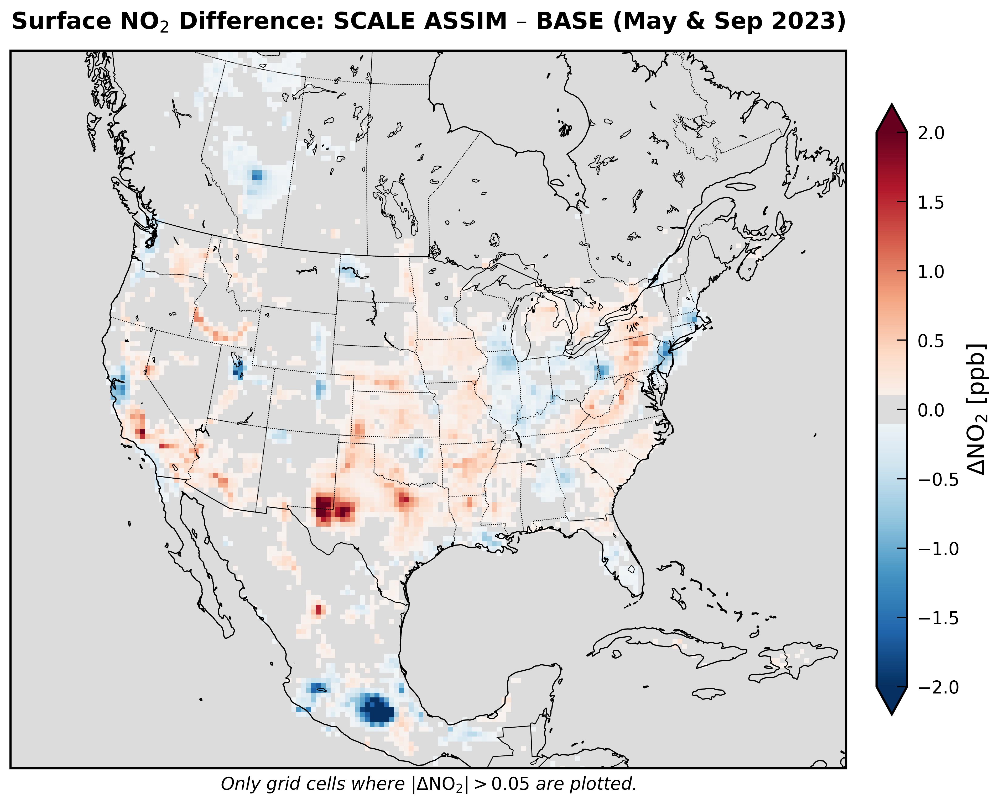

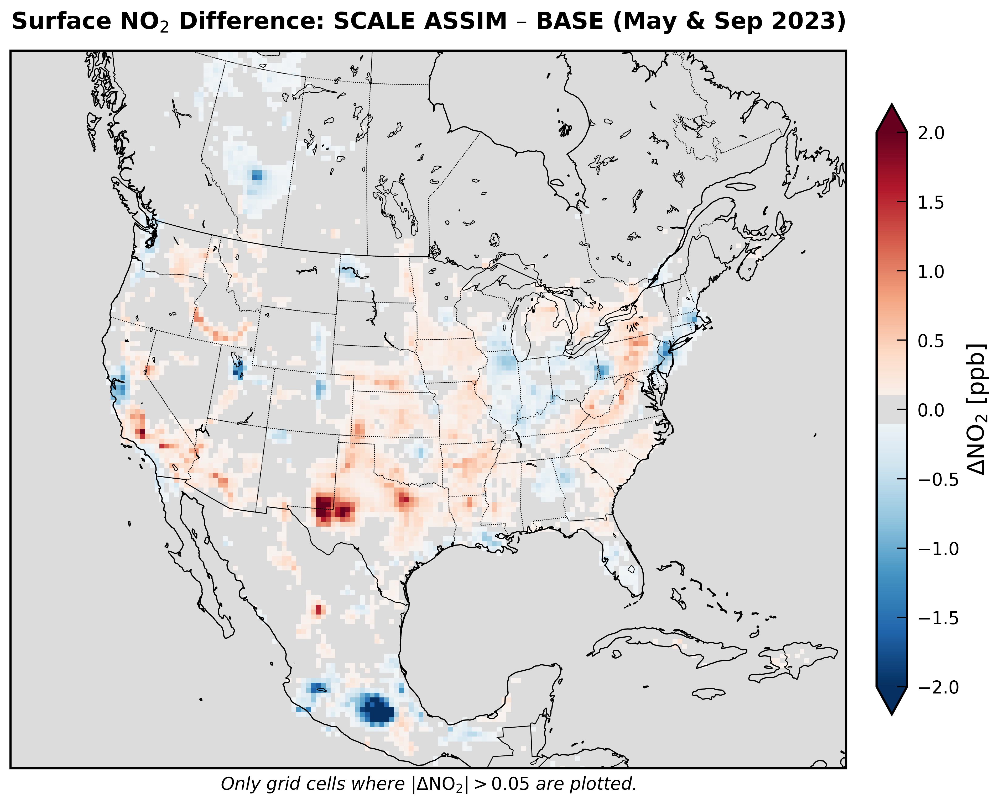

In [34]:
def plot_overall_surface_no2_s(datasets, X, Y, filename=None):
    """
    Plot domain-wide, time-averaged surface daily average NO₂ change (SCALE ASSIM - BASE).
    Uses continuous RdBu_r colormap, gainsboro background, and Cartopy features.
    """
    import matplotlib.pyplot as plt
    from matplotlib.colors import TwoSlopeNorm
    import numpy as np
    import cartopy.crs as ccrs
    import cartopy.feature as cfeature

    run = "SCALE_ASSIM"
    base_run = "BASE"
    # no2 = datasets[run]["NO2_DAILYAV"].mean(dim="TSTEP").isel(LAY=0)
    # base_no2 = datasets[base_run]["NO2_DAILYAV"].mean(dim="TSTEP").isel(LAY=0)

        # Assuming TSTEP is a pandas.DatetimeIndex
    n_jja_mask = (datasets["BASE"]["TSTEP"].dt.month == 5) | (datasets["BASE"]["TSTEP"].dt.month == 9)
    no2_n_jja = datasets[run]["NO2_DAILYAV"].isel(TSTEP=n_jja_mask).mean(dim="TSTEP").isel(LAY=0)
    base_no2_n_jja = datasets[base_run]["NO2_DAILYAV"].isel(TSTEP=n_jja_mask).mean(dim="TSTEP").isel(LAY=0)
    no2_diff_n_jja = no2_n_jja - base_no2_n_jja
    no2_diff = no2_diff_n_jja
    # no2_diff = no2 - base_no2  # No masking
    no2_diff = no2_diff.where(np.abs(no2_diff) > 0.05)  # Mask values below threshold
    vmax = 2

    fig = plt.figure(figsize=(10, 8.6))
    ax = plt.axes(projection=cmaq_proj)
    mesh = ax.pcolormesh(X, Y, no2_diff, cmap="RdBu_r", vmin=-vmax, vmax=vmax, transform=cmaq_proj)
    ax.set_facecolor('gainsboro')
    ax.text(0.5, -0.03, "Only grid cells where $|\Delta \mathrm{NO}_2| > 0.05$ are plotted.", transform=ax.transAxes, ha='center', fontsize=12, fontstyle='italic')
    ax.add_feature(cfeature.COASTLINE.with_scale('50m'), linewidth=0.8)
    ax.add_feature(cfeature.BORDERS.with_scale('50m'), linewidth=0.6)
    ax.add_feature(cfeature.STATES.with_scale('50m'), linestyle=":", linewidth=0.5)
    ax.add_feature(cfeature.LAKES.with_scale('50m'), edgecolor='black', facecolor='none', linewidth=0.5)

    cbar = plt.colorbar(mesh, ax=ax, pad=0.03, shrink=0.7, extend='both')
    cbar.ax.tick_params(labelsize=12)
    cbar.set_label("ΔNO$_2$ [ppb]", fontsize=16)
    from matplotlib.patches import Rectangle

    # Add rectangle above the colorbar
    cbar.ax.add_patch(
        Rectangle(
            (0, 0.475),   # x, y position (left of colorbar, just above)
            1.0, 0.05,       # width, height
            transform=cbar.ax.transAxes,
            color='gainsboro',
            clip_on=False
        )
    )
 
    ax.set_title("Surface NO$_2$ Difference: SCALE ASSIM – BASE (May & Sep 2023)", fontsize=16, weight="bold", pad=15)
    ax.set_aspect("equal")
    ax.set_extent([-2952000, 3204000, -2772000, 2520000], crs=cmaq_proj)
    plt.tight_layout()
    if filename:
        plt.savefig(f'./final_plots/{filename}', dpi=400, bbox_inches="tight", transparent=False)

    plt.show()

plot_overall_surface_no2_s(full_datasets, X, Y, filename="overall_surface_no2_s.png")
plot_overall_surface_no2_s(full_datasets, X, Y, filename="overall_surface_no2_s.pdf")

/tmp/ipykernel_2129/4028211254.py:98: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0.13, 1, 0.97])


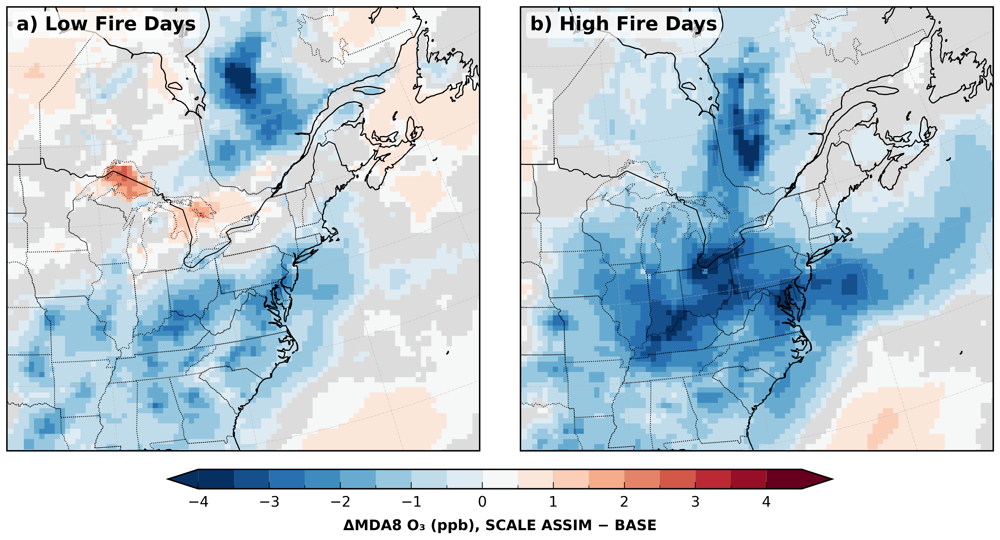

In [9]:
def plot_o3_peak_vs_nonpeak(datasets, X, Y, cmaq_proj, filename=None):
    """
    Two-panel plot of SCALE ASSIM - BASE daily MDA8 O₃ differences for
    'Low Fire Days' and 'High Fire Days' (see periods below).
    Annotates average and IQR for each panel.
    """
    import matplotlib.pyplot as plt
    from matplotlib.colors import BoundaryNorm
    import cartopy.feature as cfeature
    import numpy as np
    import pandas as pd

    # Define periods
    low_fire_ranges = [
        ("2023-06-01", "2023-06-03"),
        ("2023-06-11", "2023-06-13"),
        ("2023-06-22", "2023-06-25"),
        ("2023-07-02", "2023-07-14"),
    ]
    high_fire_ranges = [
        ("2023-06-04", "2023-06-10"),
        ("2023-06-14", "2023-06-20"),
        ("2023-06-26", "2023-06-30"),
        ("2023-07-15", "2023-07-17"),
    ]

    def get_days(ranges):
        days = []
        for start, end in ranges:
            days.extend(pd.date_range(start, end).strftime('%Y-%m-%d').tolist())
        return days

    low_days = get_days(low_fire_ranges)
    high_days = get_days(high_fire_ranges)

    # Compute means for each group
    def get_diff(days):
        o3_scale = datasets["SCALE_ASSIM"]["O3_MDA8"].sel(TSTEP=days).mean(dim="TSTEP").isel(LAY=0)
        o3_base = datasets["BASE"]["O3_MDA8"].sel(TSTEP=days).mean(dim="TSTEP").isel(LAY=0)
        diff = o3_scale - o3_base
        diff = diff.where(np.abs(diff) >= 0.25)
        return diff

    diffs = [get_diff(low_days), get_diff(high_days)]
    titles = ["Low Fire Days", "High Fire Days"]

    # Shared color scale
    vlim = 4
    levels = np.arange(-vlim, vlim + 1, 0.5)
    norm = BoundaryNorm(levels, ncolors=plt.cm.RdBu_r.N, clip=False)

    fig, axes = plt.subplots(1, 2, figsize=(15, 8), subplot_kw={'projection': cmaq_proj})
    for i, (diff, ax, label) in enumerate(zip(diffs, axes, titles)):
        mesh = ax.pcolormesh(X, Y, diff, cmap="RdBu_r", norm=norm, transform=cmaq_proj)
        ax.add_feature(cfeature.COASTLINE, linewidth=1.2)
        ax.add_feature(cfeature.BORDERS, linewidth=1)
        ax.add_feature(cfeature.STATES, linestyle=":", linewidth=0.8)
        # ax.set_title(label, fontsize=22, weight="bold", pad=12)
        ax.gridlines(draw_labels=False, linestyle="--", alpha=0.4)
        # ax.set_extent([-2952000, 3204000, -2772000, 2520000], crs=cmaq_proj)
        ax.set_extent([-100000, 3200000, -1000000, 2100000], crs=cmaq_proj)
        ax.set_facecolor('gainsboro')

        # Panel label for publication (top left)
        if i == 0:
            ax.text(0.02, 0.98, "a) Low Fire Days", transform=ax.transAxes,
                    fontsize=20, fontweight='bold', va='top', ha='left',
                    bbox=dict(facecolor='white', alpha=0.7, edgecolor='none', boxstyle='round,pad=0.2'))
                            # Panel label for publication (top left)
        if i == 1:
            ax.text(0.02, 0.98, "b) High Fire Days", transform=ax.transAxes,
                    fontsize=20, fontweight='bold', va='top', ha='left',
                    bbox=dict(facecolor='white', alpha=0.7, edgecolor='none', boxstyle='round,pad=0.2'))


        # Stats
        avg_val = float(diff.mean().compute())
        q1 = float(diff.quantile(0.25))
        q3 = float(diff.quantile(0.75))

        # ax.text(0.98, 0.10, f"Avg (IQR):\n {avg_val:.3f} ({q1:.2f}—{q3:.2f})",
        #         fontsize=16, verticalalignment="top", horizontalalignment="right",
        #         transform=ax.transAxes,
        #         bbox=dict(boxstyle="round", facecolor="white", alpha=0.85))

    # Shared colorbar
    cbar_ax = fig.add_axes([0.18, 0.08, 0.64, 0.035])
    cbar = fig.colorbar(mesh, cax=cbar_ax, orientation='horizontal', extend='both')
    cbar.set_label("ΔMDA8 O₃ (ppb), SCALE ASSIM − BASE", fontsize=15, weight='bold', labelpad=10)
    cbar.ax.tick_params(labelsize=15)

    # # Professional, descriptive main title
    # fig.suptitle(
    #     "Impact of Fire Activity on Modeled Surface Ozone Changes",
    #     fontsize=24, weight="bold", y=1.03
    # )
    # fig.text(0.5, 0.97, "Modeled MDA8 O₃ Differences on Low and High Canadian Fire Days (June–July 2023)", ha='center', fontsize=16, color='dimgray')
    plt.tight_layout(rect=[0, 0.13, 1, 0.97])
    if filename:
        plt.savefig(filename, dpi=300, bbox_inches="tight", transparent=True)
    plt.show()
    plt.close()

# ...existing code...
plot_o3_peak_vs_nonpeak(full_datasets, X, Y, cmaq_proj, filename="o3_peak_vs_nonpeak.png")

/tmp/ipykernel_2129/1682089628.py:93: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0.13, 1, 0.97])


/tmp/ipykernel_2129/1682089628.py:93: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0.13, 1, 0.97])


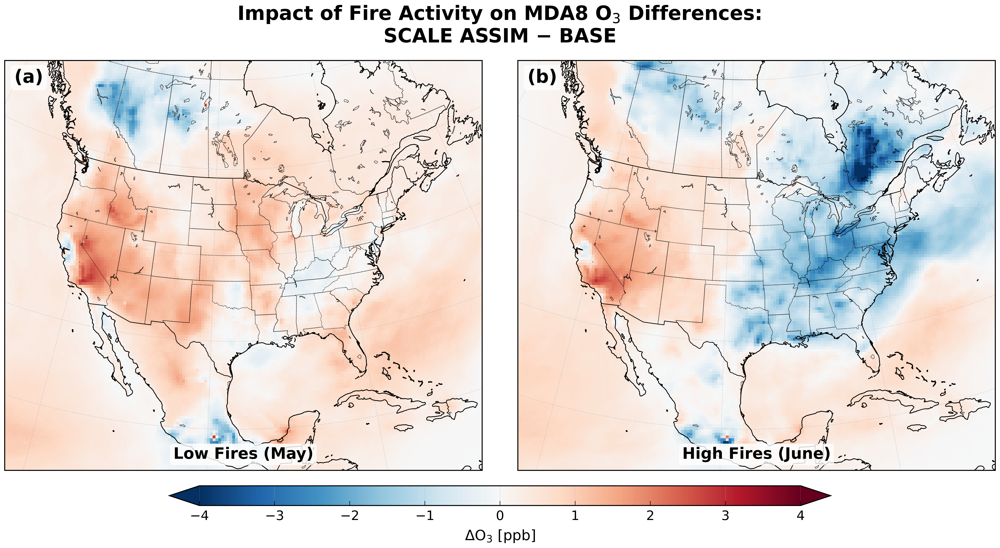

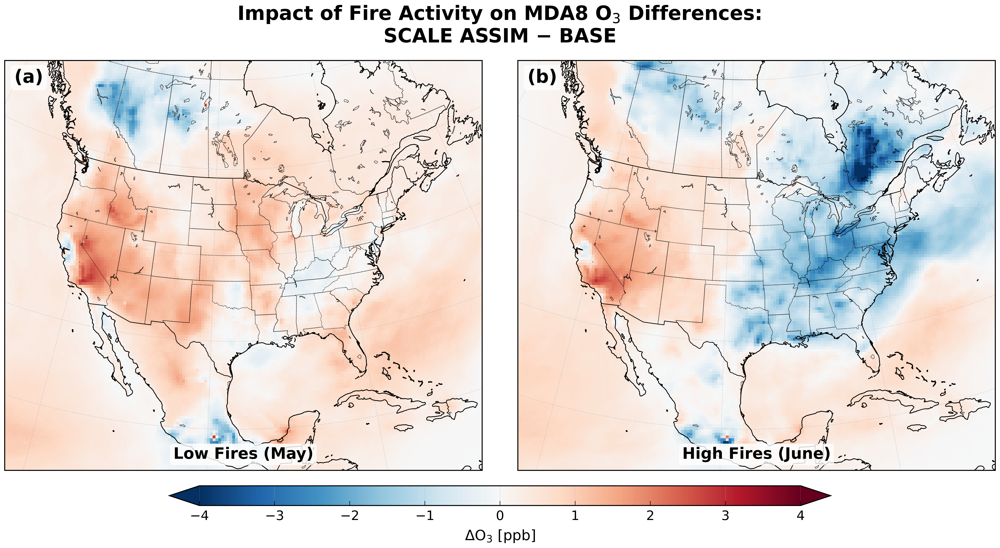

In [10]:
def plot_o3_peak_vs_nonpeak(datasets, X, Y, cmaq_proj, filename=None):
    """
    Two-panel plot of SCALE ASSIM - BASE daily MDA8 O₃ differences for
    'Low Fire Days' and 'High Fire Days' (see periods below).
    Uses a continuous colorbar, gainsboro background, and consistent masking.
    """
    import matplotlib.pyplot as plt
    from matplotlib.colors import TwoSlopeNorm
    import cartopy.feature as cfeature
    import numpy as np
    import pandas as pd

    # # Define periods
    # low_fire_ranges = [
    #     ("2023-06-01", "2023-06-03"),
    #     ("2023-06-11", "2023-06-13"),
    #     ("2023-06-22", "2023-06-25"),
    #     ("2023-07-02", "2023-07-14"),
    # ]
    # high_fire_ranges = [
    #     ("2023-06-04", "2023-06-10"),
    #     ("2023-06-14", "2023-06-20"),
    #     ("2023-06-26", "2023-06-30"),
    #     ("2023-07-15", "2023-07-17"),
    # ]
    low_fire_ranges = [
        ("2023-05-01", "2023-05-31")
    ]
    high_fire_ranges = [
        ("2023-06-01", "2023-07-01")
    ]

    def get_days(ranges):
        days = []
        for start, end in ranges:
            days.extend(pd.date_range(start, end).strftime('%Y-%m-%d').tolist())
        return days

    low_days = get_days(low_fire_ranges)
    high_days = get_days(high_fire_ranges)

    # Compute means for each group
    def get_diff(days):
        o3_scale = datasets["SCALE_ASSIM"]["O3_MDA8"].sel(TSTEP=days).mean(dim="TSTEP").isel(LAY=0)
        o3_base = datasets["BASE"]["O3_MDA8"].sel(TSTEP=days).mean(dim="TSTEP").isel(LAY=0)
        diff = o3_scale - o3_base
        # diff = diff.where(np.abs(diff) > 0.05)  # Mask values below threshold (consistent with NO2)
        return diff

    diffs = [get_diff(low_days), get_diff(high_days)]
    titles = ["Low Fires (May)", "High Fires (June)"]

    # # Shared color scale (continuous)
    vmax = 4
    # norm = TwoSlopeNorm(vcenter=0, vmin=-vmax, vmax=vmax)

    fig, axes = plt.subplots(1, 2, figsize=(22, 12), subplot_kw={'projection': cmaq_proj})
    for i, (diff, ax, label) in enumerate(zip(diffs, axes, titles)):
        mesh = ax.pcolormesh(X, Y, diff, cmap="RdBu_r", vmin=-vmax, vmax=vmax, transform=cmaq_proj)
        ax.set_facecolor('gainsboro')
        ax.add_feature(cfeature.COASTLINE.with_scale('50m'), linewidth=1.2)
        ax.add_feature(cfeature.BORDERS.with_scale('50m'), linewidth=1)
        ax.add_feature(cfeature.STATES.with_scale('50m'), linestyle=":", linewidth=0.8)
        ax.add_feature(cfeature.LAKES.with_scale('50m'), edgecolor='black', facecolor='none', linewidth=0.5)
        ax.set_extent([-2952000, 3204000, -2772000, 2520000], crs=cmaq_proj)
        ax.gridlines(draw_labels=False, linestyle="--", alpha=0.4)

        # Panel label for publication (top left)
        if i == 0:
            ax.text(0.02, 0.98, f"(a)", transform=ax.transAxes,
                    fontsize=28, fontweight='bold', va='top', ha='left',
                    bbox=dict(facecolor='white', alpha=0.8, edgecolor='none', boxstyle='round,pad=0.2'))
            ax.text(0.5, 0.02, f"{titles[0]}", transform=ax.transAxes,
                    fontsize=24, va='bottom', ha='center', weight='bold',
                    bbox=dict(facecolor='white', alpha=0.8, edgecolor='none', boxstyle='round,pad=0.2'))
        if i == 1:
            ax.text(0.02, 0.98, f"(b)", transform=ax.transAxes,
                    fontsize=28, fontweight='bold', va='top', ha='left',
                    bbox=dict(facecolor='white', alpha=0.8, edgecolor='none', boxstyle='round,pad=0.2'))
            ax.text(0.5, 0.02, f"{titles[1]}", transform=ax.transAxes,
                    fontsize=24, va='bottom', ha='center', weight='bold',
                    bbox=dict(facecolor='white', alpha=0.8, edgecolor='none', boxstyle='round,pad=0.2'))
    # Shared colorbar (continuous)
    cbar_ax = fig.add_axes([0.18, 0.08, 0.64, 0.035])
    cbar = fig.colorbar(mesh, cax=cbar_ax, orientation='horizontal', extend='both')
    cbar.set_label("ΔO$_3$ [ppb]", fontsize=22, labelpad=10)
    cbar.ax.tick_params(labelsize=20)

    plt.suptitle(
        "Impact of Fire Activity on MDA8 O$_3$ Differences: \nSCALE ASSIM − BASE",
        fontsize=30, weight="bold", y=0.97
    )
    plt.tight_layout(rect=[0, 0.13, 1, 0.97])
    if filename:
        plt.savefig(f'./final_plots/{filename}', dpi=600, bbox_inches="tight", transparent=False)

plot_o3_peak_vs_nonpeak(full_datasets, X, Y, cmaq_proj, filename="o3_peak_vs_nonpeak.png")
plot_o3_peak_vs_nonpeak(full_datasets, X, Y, cmaq_proj, filename="o3_peak_vs_nonpeak.pdf")

/tmp/ipykernel_2129/4118617395.py:93: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0.13, 1, 0.97])
/tmp/ipykernel_2129/4118617395.py:93: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0.13, 1, 0.97])


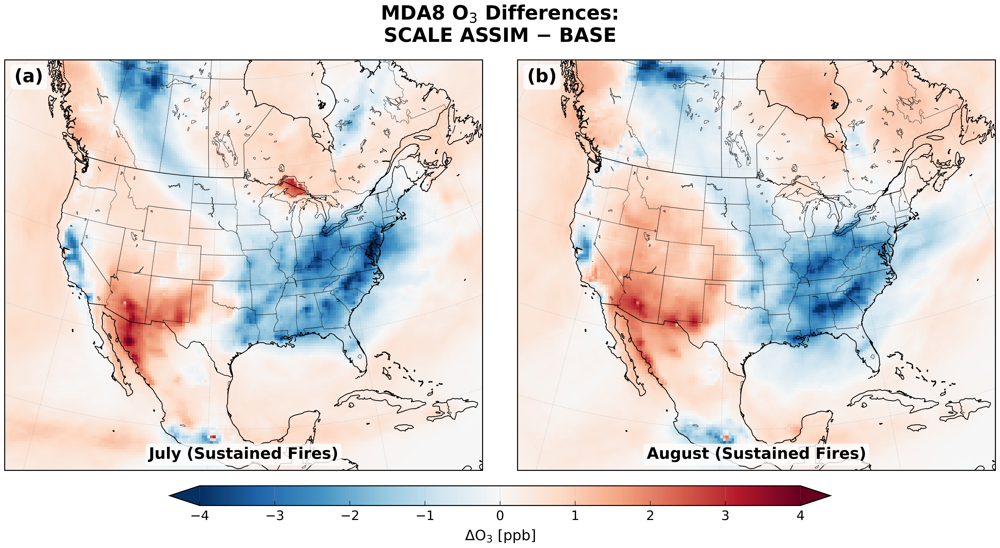

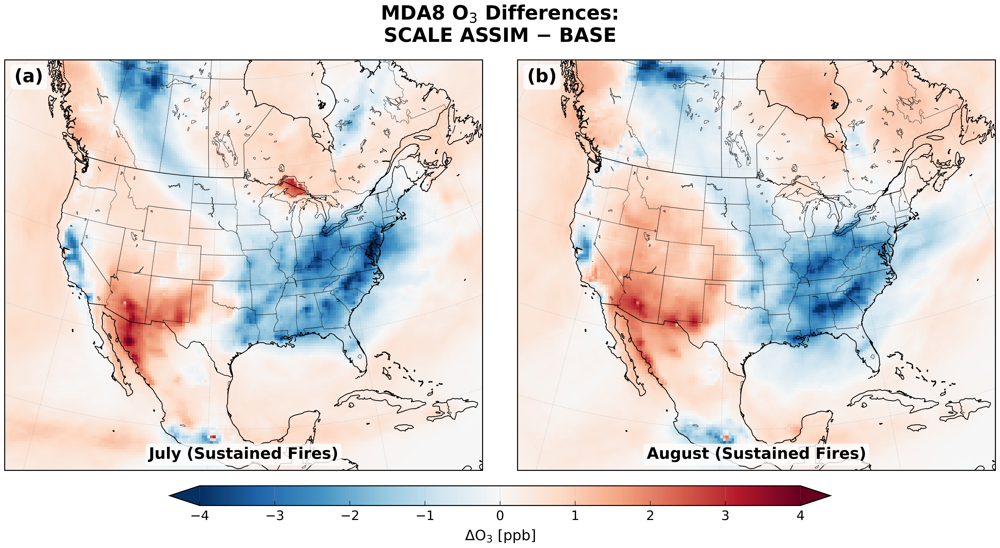

In [36]:
def plot_o3_peak_vs_nonpeak_s(datasets, X, Y, cmaq_proj, filename=None):
    """
    Two-panel plot of SCALE ASSIM - BASE daily MDA8 O₃ differences for
    'Low Fire Days' and 'High Fire Days' (see periods below).
    Uses a continuous colorbar, gainsboro background, and consistent masking.
    """
    import matplotlib.pyplot as plt
    from matplotlib.colors import TwoSlopeNorm
    import cartopy.feature as cfeature
    import numpy as np
    import pandas as pd

    # # Define periods
    # low_fire_ranges = [
    #     ("2023-06-01", "2023-06-03"),
    #     ("2023-06-11", "2023-06-13"),
    #     ("2023-06-22", "2023-06-25"),
    #     ("2023-07-02", "2023-07-14"),
    # ]
    # high_fire_ranges = [
    #     ("2023-06-04", "2023-06-10"),
    #     ("2023-06-14", "2023-06-20"),
    #     ("2023-06-26", "2023-06-30"),
    #     ("2023-07-15", "2023-07-17"),
    # ]
    low_fire_ranges = [
        ("2023-07-01", "2023-07-31")
    ]
    high_fire_ranges = [
        ("2023-08-01", "2023-08-31")
    ]

    def get_days(ranges):
        days = []
        for start, end in ranges:
            days.extend(pd.date_range(start, end).strftime('%Y-%m-%d').tolist())
        return days

    low_days = get_days(low_fire_ranges)
    high_days = get_days(high_fire_ranges)

    # Compute means for each group
    def get_diff(days):
        o3_scale = datasets["SCALE_ASSIM"]["O3_MDA8"].sel(TSTEP=days).mean(dim="TSTEP").isel(LAY=0)
        o3_base = datasets["BASE"]["O3_MDA8"].sel(TSTEP=days).mean(dim="TSTEP").isel(LAY=0)
        diff = o3_scale - o3_base
        # diff = diff.where(np.abs(diff) > 0.05)  # Mask values below threshold (consistent with NO2)
        return diff

    diffs = [get_diff(low_days), get_diff(high_days)]
    titles = ["July (Sustained Fires)", "August (Sustained Fires)"]

    # # Shared color scale (continuous)
    vmax = 4
    # norm = TwoSlopeNorm(vcenter=0, vmin=-vmax, vmax=vmax)

    fig, axes = plt.subplots(1, 2, figsize=(22, 12), subplot_kw={'projection': cmaq_proj})
    for i, (diff, ax, label) in enumerate(zip(diffs, axes, titles)):
        mesh = ax.pcolormesh(X, Y, diff, cmap="RdBu_r", vmin=-vmax, vmax=vmax, transform=cmaq_proj)
        ax.set_facecolor('gainsboro')
        ax.add_feature(cfeature.COASTLINE.with_scale('50m'), linewidth=1.2)
        ax.add_feature(cfeature.BORDERS.with_scale('50m'), linewidth=1)
        ax.add_feature(cfeature.STATES.with_scale('50m'), linestyle=":", linewidth=0.8)
        ax.add_feature(cfeature.LAKES.with_scale('50m'), edgecolor='black', facecolor='none', linewidth=0.5)
        ax.set_extent([-2952000, 3204000, -2772000, 2520000], crs=cmaq_proj)
        ax.gridlines(draw_labels=False, linestyle="--", alpha=0.4)

        # Panel label for publication (top left)
        if i == 0:
            ax.text(0.02, 0.98, f"(a)", transform=ax.transAxes,
                    fontsize=28, fontweight='bold', va='top', ha='left',
                    bbox=dict(facecolor='white', alpha=0.8, edgecolor='none', boxstyle='round,pad=0.2'))
            ax.text(0.5, 0.02, f"{titles[0]}", transform=ax.transAxes,
                    fontsize=24, va='bottom', ha='center', weight='bold',
                    bbox=dict(facecolor='white', alpha=0.8, edgecolor='none', boxstyle='round,pad=0.2'))
        if i == 1:
            ax.text(0.02, 0.98, f"(b)", transform=ax.transAxes,
                    fontsize=28, fontweight='bold', va='top', ha='left',
                    bbox=dict(facecolor='white', alpha=0.8, edgecolor='none', boxstyle='round,pad=0.2'))
            ax.text(0.5, 0.02, f"{titles[1]}", transform=ax.transAxes,
                    fontsize=24, va='bottom', ha='center', weight='bold',
                    bbox=dict(facecolor='white', alpha=0.8, edgecolor='none', boxstyle='round,pad=0.2'))
    # Shared colorbar (continuous)
    cbar_ax = fig.add_axes([0.18, 0.08, 0.64, 0.035])
    cbar = fig.colorbar(mesh, cax=cbar_ax, orientation='horizontal', extend='both')
    cbar.set_label("ΔO$_3$ [ppb]", fontsize=22, labelpad=10)
    cbar.ax.tick_params(labelsize=20)

    plt.suptitle(
        "MDA8 O$_3$ Differences: \nSCALE ASSIM − BASE",
        fontsize=30, weight="bold", y=0.97
    )
    plt.tight_layout(rect=[0, 0.13, 1, 0.97])
    if filename:
        plt.savefig(f'./final_plots/{filename}', dpi=600, bbox_inches="tight", transparent=False)

plot_o3_peak_vs_nonpeak_s(full_datasets, X, Y, cmaq_proj, filename="o3_peak_vs_nonpeak_s.png")
plot_o3_peak_vs_nonpeak_s(full_datasets, X, Y, cmaq_proj, filename="o3_peak_vs_nonpeak_s.pdf")